# WAVE EQUATION (1-dim) with Dirichlet Boundary Conditions

### Given by

$$
\large
\begin{aligned}
&u_{tt} = c^{2}u_{xx}, \; \; 0 < x < \ell, t > 0 \\
&u(x,0) = \phi(x) \\
&u_{t}(x,0) = \psi(x) \\
&u(0,t) = g(t), \; u(\ell, t) = h(t) \\
\end{aligned}
$$

where c is the wave speed

$
\begin{aligned}
&\text{Similarly to what was have previously done, use the second order centered finite difference for} \; u_{tt} \; \text{and} \; u_{xx} \\
&\text{and then solve the equation for the n+1th time step. This results in:} \\
&u^{n+1}_{j} = s(u^{n}_{j-1} + u^{n}_{j-1}) + 2(1-s)u^{n}_{j} - u^{n-1}_{j} \\
&\text{where} \; s = (\frac{c\Delta t}{\Delta x})^{2} \; \text{with constraint that} \; s \leq 1 \; \text{to ensure stability of solution} \\ \\
&\text{to enforce initial conditions,} \; \phi, \psi, \; \text{we will need first 2 rows of the solution matrix to be inital conditions.} \\ \\
&\text{let:} \\
&u^{0}_{j} = \phi_{j} \\
&\text{use centered difference to expand} \; u_{t}(x,0) \\
&u_{t}(x,0) = \frac{u^{1}_{j} - u^{-1}_{j}}{2\Delta t} = \psi_{j} \\
&\text{now using our (n+1)th update we have} \\
&u^{1}_{j} + u^{-1}_{j} = s(u^{0}_{j-1} + u^{0}_{j-1}) + 2(1-s)u^{0}_{j} \\
&\text{in addition with our centered difference expansion we get the 2nd row of our solution matrix defined by:} \\
&u^{1}_{j} = \frac{s}{2}(\phi_{j-1} + \phi_{j+1}) + (1-s)\phi_{j} + \psi_{j}\Delta t \\
&\text{then we enforce our boundary conditions like we did previously in the heat equation, and this will be the scheme to find our solution}
\end{aligned}
$

In [2]:
from utils import *

In [3]:
def wave_equation_solver(x, t, s, phi, psi, g, h):
    '''
    x: space domain (i.e., length of string)
    t: time domain
    s: mesh factor
    phi: initial wave displacement
    psi: initial wave velocity
    g: dirichlet boundary condition
    h: dirichlet boundary condition
    '''
    dx = x[1] - x[0]
    dt = t[1] - t[0]
    u = np.zeros((len(t), len(x)))
    u[0, :] = phi
    
    u[0, 0] = g[0]
    u[0, -1] = h[0]

    u[1, 1:-1] = (s/2)*(phi[2:] + phi[:-2]) + (1-s)*phi[1:-1] + psi[1:-1]*dt
    
    for n in range(1, len(u)-1):
        u[n+1, 0] = g[n]
        u[n+1, -1] = h[n]
        u[n+1, 1:-1] = s*(u[n, 2:] + u[n, :-2]) + 2*(1-s)*u[n, 1:-1] - u[n-1, 1:-1] 

    return u

## Example with no initial wave velocity

In [4]:
dx = .01 # mesh size for spatial variable
s = .5 # mesh factor, needs to be <= 1 to ensure stability of solution
c = 1
dt = np.sqrt((s*dx**2)/c**2) # mesh size for time variable

x0 = 0 # spatial starting point
xL = 1 # spatial ending point

t0 = 0 # time starting point
tL = 5 # time starting point

x = np.arange(x0, xL+dx, dx) # space array
t = np.arange(t0, tL+dt, dt) #time array

phi = np.sin(np.pi * x) #initial condition
psi = np.zeros(len(x))

g = [0 for _ in range(len(t))]
h = g

u = wave_equation_solver(x, t, s, phi, psi, g, h)

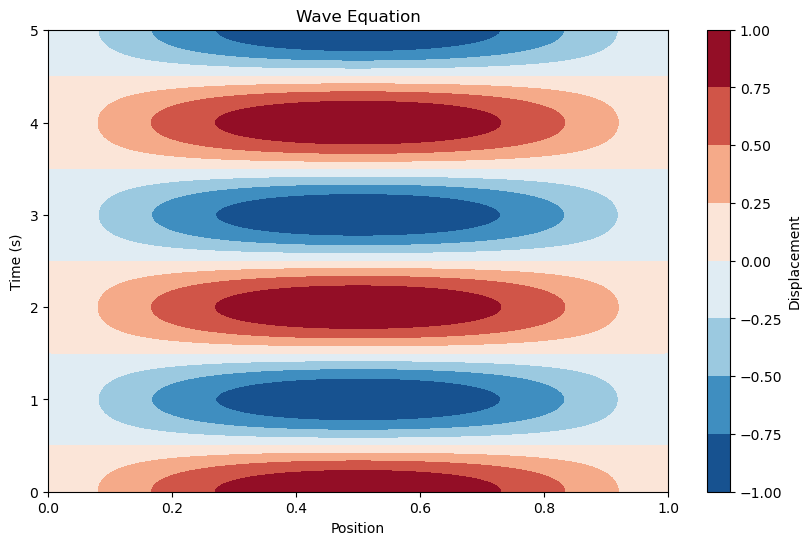

In [5]:
plot(x, t, u, is_heat=False)

In [6]:
ani = animated_plot(x, t, u, is_dirichlet=True, is_heat=False)
HTML(ani.to_jshtml())

## Example with initial Wave Displacement and Velocity

In [7]:
dx = .01 # mesh size for spatial variable
s = .5 # mesh factor, needs to be <= 1 to ensure stability of solution
c = 1
dt = np.sqrt((s*dx**2)/c**2) # mesh size for time variable

x0 = 0 # spatial starting point
xL = 1 # spatial ending point

t0 = 0 # time starting point
tL = 5 # time starting point

x = np.arange(x0, xL+dx, dx) # space array
t = np.arange(t0, tL+dt, dt) #time array

phi = np.sin(np.pi * x) + .5*np.sin(2*np.pi*x) #initial displacement
psi = np.tanh(np.pi * x) #initial velocity

g = [0 for _ in range(len(t))]
h = g

u = wave_equation_solver(x, t, s, phi, psi, g, h)

In [8]:
ani = animated_plot(x, t, u, is_dirichlet=True, is_heat=False)
HTML(ani.to_jshtml())